In [1]:
import numpy as np
import matplotlib.pyplot as plt
import json
import os
from PIL import Image
from tqdm import tqdm

In [2]:
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torch.utils.data import DataLoader, Dataset
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

import albumentations as A
from albumentations.pytorch import ToTensorV2

/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.23 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [3]:
import wandb
from sklearn.metrics import confusion_matrix, roc_curve, precision_recall_curve

In [4]:
data_dir = '/scratch/user/junhokim/data/'
folders = [f for f in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, f))]
print(folders)
beauty_dir = data_dir + "BEAUTY1.0_COCOLike/Split0/JPEGImages"
print(beauty_dir)
print(os.path.isdir(beauty_dir))

['Checkpoints', 'BEAUTY1.0_COCOLike']
/scratch/user/junhokim/data/BEAUTY1.0_COCOLike/Split0/JPEGImages
True


In [5]:
class BuildingDataset(Dataset):
    def __init__(self, json_file, root_dir, transform=None):
        # Load the data from the JSON file
        with open(json_file, 'r') as f:
            self.data = json.load(f)

        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        # Get image data and bounding box information
        image_data = self.data[idx]
        image_path = os.path.join(self.root_dir, image_data["file_name"])
        image = Image.open(image_path).convert("RGB")

        # Convert bounding boxes from [x, y, width, height] to [x_min, y_min, x_max, y_max]
        bboxes = []
        labels = []
        for bbox in image_data["annotations"]:
            x, y, width, height = bbox
            x_min, y_min = x, y
            x_max, y_max = x + width, y + height
            bboxes.append([x_min, y_min, x_max, y_max])
            labels.append(1)  # Assign label '1' to all buildings

        # Apply transformations
        if self.transform:
            transformed = self.transform(image=np.array(image), bboxes=bboxes, labels=labels)
            image = transformed["image"]
            bboxes = transformed["bboxes"]
            labels = transformed["labels"]

        # Convert bounding boxes and labels to tensors
        target = {
            "boxes": torch.tensor(bboxes, dtype=torch.float32),
            "labels": torch.tensor(labels, dtype=torch.int64)
        }

        return image, target

In [7]:
experiment_id = 'exp4'
checkpoint_dir = f'/scratch/user/junhokim/data/Checkpoints/checkpoints_{experiment_id}'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Finetuned Faster R-CNN
checkpoint_dir = checkpoint_dir + '/best_model.pth'
checkpoint = torch.load(checkpoint_dir, map_location=device)
# model_ft = fasterrcnn_resnet50_fpn(pretrained=True)
model_ft = fasterrcnn_resnet50_fpn(weights=True)
in_features = model_ft.roi_heads.box_predictor.cls_score.in_features
model_ft.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes=2)
model_ft.load_state_dict(checkpoint['model_state_dict'])
model_ft.to(device)

/tmp/ipykernel_242871/4014292118.py:7: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_dir, map_location=device)


/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [20]:
# Calculate Intersection over Union (IoU) between two boxes
def calculate_iou(box1, box2):
    x1_inter = max(box1[0], box2[0])
    y1_inter = max(box1[1], box2[1])
    x2_inter = min(box1[2], box2[2])
    y2_inter = min(box1[3], box2[3])

    inter_area = max(0, x2_inter - x1_inter) * max(0, y2_inter - y1_inter)

    box1_area = max(0, box1[2] - box1[0]) * max(0, box1[3] - box1[1])
    box2_area = max(0, box2[2] - box2[0]) * max(0, box2[3] - box2[1])

    union_area = box1_area + box2_area - inter_area

    iou = inter_area / union_area if union_area != 0 else 0
    return iou

def compute_ap(gt_boxes, pred_boxes, pred_scores, iou_threshold=0.5):
    # Sort predictions by descending confidence
    sorted_indices = np.argsort(-pred_scores)
    pred_boxes = pred_boxes[sorted_indices]
    pred_scores = pred_scores[sorted_indices]

    tp = np.zeros(len(pred_boxes))
    fp = np.zeros(len(pred_boxes))
    matched_gt = np.zeros(len(gt_boxes))

    for i, pred_box in enumerate(pred_boxes):
        ious = np.array([calculate_iou(pred_box, gt_box) for gt_box in gt_boxes])
        max_iou = np.max(ious) if len(ious) > 0 else 0
        max_iou_idx = np.argmax(ious) if len(ious) > 0 else -1

        if max_iou >= iou_threshold and matched_gt[max_iou_idx] == 0:
            tp[i] = 1
            matched_gt[max_iou_idx] = 1  # Mark this GT as matched
        else:
            fp[i] = 1

    # Compute cumulative true positives and false positives
    cum_tp = np.cumsum(tp)
    cum_fp = np.cumsum(fp)

    # recalls = cum_tp / len(gt_boxes)
    # precisions = cum_tp / (cum_tp + cum_fp)

    recalls = cum_tp / len(gt_boxes) if len(gt_boxes) > 0 else np.array([0])
    precisions = cum_tp / (cum_tp + cum_fp + 1e-8)

    # Ensure precision-recall curve starts from (0,1)
    recalls = np.concatenate(([0.], recalls))
    precisions = np.concatenate(([1.], precisions))

    # Compute AP as area under the precision-recall curve
    ap = np.trapz(precisions, recalls)
    return ap, precisions, recalls

# Evaluate the model on the test set and calculate mAP
def evaluate_model_on_test_set(model, test_loader, device, iou_threshold=0.5):
    model.eval()
    all_gt_boxes = []
    all_pred_boxes = []
    all_pred_scores = []

    # Also store binary predictions for ROC/Confusion matrix
    # We'll define a threshold for binary classification for demonstration purposes
    binary_threshold = 0.8
    binary_true = []
    binary_pred = []

    with torch.no_grad():
        for images, targets in tqdm(test_loader, desc="Evaluating"):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                gt_boxes = targets[i]['boxes'].cpu().numpy()
                all_gt_boxes.extend(gt_boxes)

                pred_boxes = outputs[i]['boxes'].cpu().numpy()
                pred_scores = outputs[i]['scores'].cpu().numpy()

                all_pred_boxes.extend(pred_boxes)
                all_pred_scores.extend(pred_scores)

                # TODO: Test this evaluation methods
                # For binary classification: any GT means positive
                # If no bounding box is given as GT, treat as negative
                # This is simplistic and may not reflect true object detection metrics.
                gt_label = 1 if len(gt_boxes) > 0 else 0
                # Predict positive if any predicted box score > threshold
                pred_label = 1 if np.any(pred_scores > binary_threshold) else 0

                binary_true.append(gt_label)
                binary_pred.append(pred_label)

    all_gt_boxes = np.array(all_gt_boxes)
    all_pred_boxes = np.array(all_pred_boxes)
    all_pred_scores = np.array(all_pred_scores)

    # Proceed to compute AP
    ap, precisions, recalls = compute_ap(all_gt_boxes,
                                        all_pred_boxes, 
                                        all_pred_scores, 
                                        iou_threshold)
    # return ap, precisions, recalls

    # Compute binary metrics for demonstration (Confusion Matrix, ROC)
    cm = confusion_matrix(binary_true, binary_pred)
    fpr, tpr, _ = roc_curve(binary_true, binary_pred)
    prec_curve, rec_curve, _ = precision_recall_curve(binary_true, binary_pred)

    # return ap, precisions, recalls, cm, (fpr, tpr), (prec_curve, rec_curve)
    return ap, precisions, recalls, cm, (fpr, tpr), (prec_curve, rec_curve), binary_true, binary_pred


def plot_precision_recall_curve(precisions, recalls):
    plt.figure(figsize=(8, 6))
    plt.plot(recalls, precisions, marker='.')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.grid(True)
    plt.show()

In [11]:
# Define a simple test transformation
def get_test_transform():
    return A.Compose([
        A.Resize(512, 512),                             # Resize to 512x512
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),  # Normalization
        ToTensorV2()
    ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['labels']))

# Path to test dataset JSON file
test_file = f'/scratch/user/junhokim/code/datasplits/datasplit_{experiment_id}/test_data.json'

test_transform = get_test_transform()
test_dataset = BuildingDataset(json_file=test_file, root_dir=beauty_dir, transform=test_transform)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

In [21]:
# Initialize wandb
wandb.init(project="geolocation-building-detection-results", name="building_detection_eval")

Fine_Tuned_AP,▁
Fine_Tuned_AP,0.54096


In [26]:
iou_threshold = 0.5

def test(model, model_name, iou_threshold):
    print(f"Evaluating {model_name} on Test Set...")
    # ap, precisions, recalls, cm, (fpr, tpr), (prec_curve, rec_curve) = evaluate_model_on_test_set(model, test_loader, device, iou_threshold)
    ap, precisions, recalls, cm, (fpr, tpr), (prec_curve, rec_curve), binary_true, binary_pred = evaluate_model_on_test_set(model, test_loader, device, iou_threshold)


    print(f"{model_name} AP @ IoU={iou_threshold}: {ap:.4f}")

    # Log AP to W&B
    wandb.log({f"{model_name}_AP": ap})

    # Plot PR curve
    plt.figure(figsize=(8, 6))
    plt.plot(recalls, precisions, marker='.', label=f"{model_name}")
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.grid(True)
    # Return figure instead of printing
    pr_fig = plt.gcf()

    # Log PR figure to W&B (just this model now)
    wandb.log({f"{model_name}_PR_Curve": wandb.Image(pr_fig)})
    plt.close(pr_fig)

    # Log ROC Curve
    plt.figure()
    plt.plot(fpr, tpr, label=f"{model_name} ROC")
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    roc_fig = plt.gcf()
    wandb.log({f"{model_name}_ROC_Curve": wandb.Image(roc_fig)})
    plt.close(roc_fig)

    # Log Confusion Matrix
    # class_names = ["no_building", "building"]
    # y_true_str = [class_names[yt] for yt in binary_true]
    # y_pred_str = [class_names[yp] for yp in binary_pred]

    # wandb.log({"conf_mat": wandb.plot.confusion_matrix(
    #     y_true=y_true_str,
    #     preds=y_pred_str,
    #     class_names=class_names)})

    return ap, precisions, recalls

# def test(model, iou_threshold):
#     print("Evaluating Model on Test Set...")
#     ap, precisions, recalls = evaluate_model_on_test_set(model, test_loader, device, iou_threshold)
#     print(f"Model AP @ IoU={iou_threshold}: {ap:.4f}")

#     # Plot Precision-Recall curve
#     plot_precision_recall_curve(precisions, recalls)

# Run model evaluation
# test(model_ft, iou_threshold)

In [27]:
# Run model evaluation for fine-tuned model
ap_ft, precisions_ft, recalls_ft = test(model_ft, "Fine_Tuned", iou_threshold)

Evaluating Fine_Tuned on Test Set...


Evaluating: 100%|██████████| 60/60 [00:09<00:00,  6.09it/s]


Fine_Tuned AP @ IoU=0.5: 0.7313


/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/sklearn/metrics/_ranking.py:1174: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(


In [28]:
# Pretrained Model
# Use same classification number to load pretrained weights
model_pt = fasterrcnn_resnet50_fpn(pretrained=True)
model_pt.to(device)

/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

In [29]:
ap_pt, precisions_pt, recalls_pt = test(model_pt, "Pretrained", iou_threshold)

Evaluating Pretrained on Test Set...


Evaluating: 100%|██████████| 60/60 [00:09<00:00,  6.03it/s]
/scratch/user/junhokim/.conda/envs/obj_detect/lib/python3.9/site-packages/sklearn/metrics/_ranking.py:1174: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(


Pretrained AP @ IoU=0.5: 0.0175


In [30]:
# Now let's plot both PR curves together and log as a combined figure
plt.figure(figsize=(8, 6))
plt.plot(recalls_ft, precisions_ft, marker='.', label="Fine-Tuned")
plt.plot(recalls_pt, precisions_pt, marker='.', label="Pretrained")
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Comparison of PR Curves')
plt.legend()
plt.grid(True)
combined_pr_fig = plt.gcf()

# Log combined PR curve figure to W&B
wandb.log({"Combined_PR_Curve": wandb.Image(combined_pr_fig)})
plt.close(combined_pr_fig)

# Finish W&B run
wandb.finish()

Fine_Tuned_AP,▁▁
Pretrained_AP,▁
Fine_Tuned_AP,0.73133
Pretrained_AP,0.01748


### Bounding Box Visualization

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def visualize_predictions(model, test_loader, device, num_images=21):
    model.eval()
    images_so_far = 0

    # Create a figure with 3 rows and 7 columns
    fig, axes = plt.subplots(nrows=7, ncols=3, figsize=(10, 20))
    axes = axes.flatten()

    with torch.no_grad():
        for images, targets in test_loader:
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                if images_so_far >= num_images:
                    break

                # Move the image back to CPU and convert to numpy
                img = images[i].cpu().permute(1, 2, 0).numpy()
                # Unnormalize the image
                img = img * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
                img = np.clip(img, 0, 1)

                gt_boxes = targets[i]['boxes'].cpu().numpy()
                pred_boxes = outputs[i]['boxes'].cpu().numpy()
                pred_scores = outputs[i]['scores'].cpu().numpy()

                # Plot the image
                ax = axes[images_so_far]
                ax.imshow(img)
                ax.axis('off')

                # Draw ground truth boxes in green
                for box in gt_boxes:
                    x_min, y_min, x_max, y_max = box
                    rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                             linewidth=2, edgecolor='g', facecolor='none')
                    ax.add_patch(rect)

                # Draw predicted boxes in red if the score is above a threshold (e.g., 0.5)
                for idx, box in enumerate(pred_boxes):
                    score = pred_scores[idx]
                    if score < 0.8:
                        continue  # Skip low-confidence predictions
                    x_min, y_min, x_max, y_max = box
                    rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                             linewidth=2, edgecolor='r', facecolor='none')
                    ax.add_patch(rect)

                    # Display the confidence score (Optional)
                    ax.text(x_min, y_min, f'{score:.2f}', color='white', fontsize=8, backgroundcolor='red')

                images_so_far += 1
                if images_so_far >= num_images:
                    break

            if images_so_far >= num_images:
                break

    plt.tight_layout()
    plt.show()

In [ ]:
visualize_predictions(model_ft, test_loader, device, num_images=21)

In [ ]:
visualize_predictions(model_pt, test_loader, device, num_images=21)

## Fixed Confidence Threshold

In [12]:
def evaluate_at_confidence_threshold(gt_boxes, pred_boxes, pred_scores, confidence_threshold, iou_threshold=0.5):
    # Filter predictions by confidence threshold
    indices = pred_scores >= confidence_threshold
    pred_boxes = pred_boxes[indices]
    pred_scores = pred_scores[indices]
    
    tp = np.zeros(len(pred_boxes))
    fp = np.zeros(len(pred_boxes))
    matched_gt = np.zeros(len(gt_boxes))
    
    for i, pred_box in enumerate(pred_boxes):
        ious = np.array([calculate_iou(pred_box, gt_box) for gt_box in gt_boxes])
        max_iou = np.max(ious) if len(ious) > 0 else 0
        max_iou_idx = np.argmax(ious) if len(ious) > 0 else -1

        if max_iou >= iou_threshold and matched_gt[max_iou_idx] == 0:
            tp[i] = 1
            matched_gt[max_iou_idx] = 1  # Mark this GT as matched
        else:
            fp[i] = 1

    total_tp = np.sum(tp)
    total_fp = np.sum(fp)
    total_fn = len(gt_boxes) - np.sum(matched_gt)

    precision = total_tp / (total_tp + total_fp) if (total_tp + total_fp) > 0 else 0
    recall = total_tp / (total_tp + total_fn) if (total_tp + total_fn) > 0 else 0

    return precision, recall

In [13]:
def evaluate_model_with_fixed_confidence(model, test_loader, device, iou_threshold=0.5, confidence_threshold=None):
    model.eval()
    all_gt_boxes = []
    all_pred_boxes = []
    all_pred_scores = []

    with torch.no_grad():
        for images, targets in tqdm(test_loader, desc="Evaluating"):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                gt_boxes = targets[i]['boxes'].cpu().numpy()
                all_gt_boxes.extend(gt_boxes)

                pred_boxes = outputs[i]['boxes'].cpu().numpy()
                pred_scores = outputs[i]['scores'].cpu().numpy()

                all_pred_boxes.extend(pred_boxes)
                all_pred_scores.extend(pred_scores)

    all_gt_boxes = np.array(all_gt_boxes)
    all_pred_boxes = np.array(all_pred_boxes)
    all_pred_scores = np.array(all_pred_scores)

    # Compute AP
    ap, precisions, recalls = compute_ap(all_gt_boxes, all_pred_boxes, all_pred_scores, iou_threshold)

    # Compute precision and recall at a fixed confidence threshold (if provided)
    if confidence_threshold is not None:
        precision, recall = evaluate_at_confidence_threshold(
            all_gt_boxes, all_pred_boxes, all_pred_scores, confidence_threshold, iou_threshold
        )
        return ap, precisions, recalls, precision, recall
    else:
        return ap, precisions, recalls

In [14]:
def test(model, confidence_threshold, iou_threshold):
    print("Evaluating Model on Test Set...")
    ap, precisions, recalls, precision_at_thresh, recall_at_thresh = evaluate_model_with_fixed_confidence(
        model, test_loader, device, iou_threshold, confidence_threshold
    )
    print(f"Model AP @ IoU={iou_threshold}: {ap:.4f}")
    print(f"Precision at confidence {confidence_threshold}: {precision_at_thresh:.4f}")
    print(f"Recall at confidence {confidence_threshold}: {recall_at_thresh:.4f}")

    # Plot Precision-Recall curve
    plot_precision_recall_curve(precisions, recalls)

Evaluating Model on Test Set...


Evaluating: 100%|██████████| 60/60 [00:14<00:00,  4.18it/s]


Model AP @ IoU=0.6: 0.7135
Precision at confidence 0.8: 0.6516
Recall at confidence 0.8: 0.7216


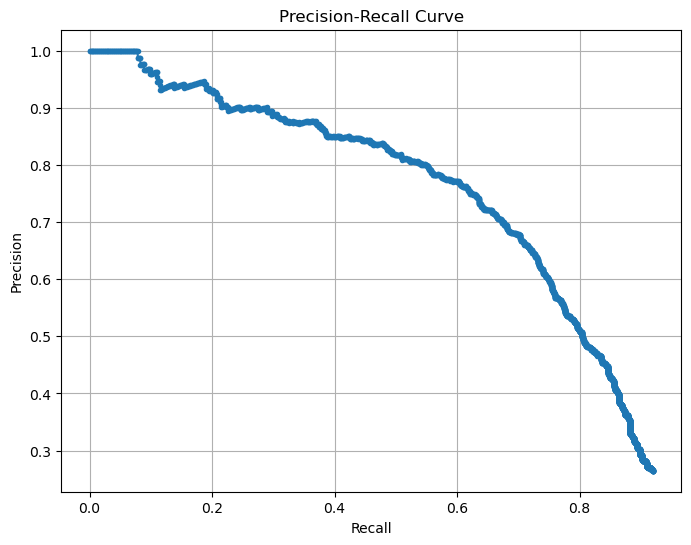

In [15]:
confidence_threshold = 0.8
iou_threshold=0.6

test(model_ft, confidence_threshold, iou_threshold)

## NOAA Inference Dataset
* UnidentifiedImageError: cannot identify image file '/scratch/user/junhokim/data/NOAA_Sample/3438985_2095568.jpg'
* UnidentifiedImageError: cannot identify image file '/scratch/user/junhokim/data/NOAA_Sample/3434933_2093529.jpg'
* UnidentifiedImageError: cannot identify image file '/scratch/user/junhokim/data/NOAA_Sample/3434772_2092944.jpg'

In [16]:
class InferenceDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        # List all image files in the directory
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith('.jpg') or f.endswith('.png')]
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        # Get image file name
        image_file = self.image_files[idx]
        image_path = os.path.join(self.root_dir, image_file)
        # Load image
        image = Image.open(image_path).convert("RGB")

        # Apply transformations
        if self.transform:
            image = self.transform(image=np.array(image))['image']

        return image, image_file  # Return image and its filename

In [17]:
class InferenceDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        self.root_dir = root_dir
        self.transform = transform
        self.image_files = [f for f in os.listdir(root_dir) if f.endswith('.jpg') or f.endswith('.png')]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        image_file = self.image_files[idx]
        image_path = os.path.join(self.root_dir, image_file)
        try:
            # Load image
            image = Image.open(image_path).convert("RGB")
            # Apply transformations
            if self.transform:
                image = self.transform(image=np.array(image))['image']
            return image, image_file
        except Exception as e:
            # Handle the exception (e.g., log it) and return None
            print(f"Error loading image {image_file}: {e}")
            return None  # Indicate that this sample should be skipped

In [18]:
def get_inference_transform():
    return A.Compose([
        A.Resize(512, 512),  # Resize to match training dimensions
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2()
    ])

def collate_fn(batch):
    images, image_files = zip(*batch)
    images = list(images)
    image_files = list(image_files)
    return images, image_files

# Directory containing your images
noaa_dir = '/scratch/user/junhokim/data/NOAA_Sample'

# Initialize the dataset and dataloader
inference_transform = get_inference_transform()
inference_dataset = InferenceDataset(root_dir=noaa_dir, transform=inference_transform)
inference_loader = DataLoader(inference_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

In [19]:
def run_inference(model, data_loader, device, num_images_to_visualize=30):
    model.eval()
    model.to(device)
    predictions = []
    images_to_visualize = []
    image_files_to_visualize = []
    images_collected = 0

    with torch.no_grad():
        # Add tqdm progress bar here
        for images, image_files in tqdm(data_loader, desc="Running Inference"):
            images = [img.to(device) for img in images]
            outputs = model(images)

            for i in range(len(images)):
                # Collect images and filenames for visualization
                if images_collected < num_images_to_visualize:
                    img = images[i].cpu().permute(1, 2, 0).numpy()
                    # Unnormalize
                    img = img * np.array([0.229, 0.224, 0.225]) + \
                          np.array([0.485, 0.456, 0.406])
                    img = np.clip(img, 0, 1)
                    images_to_visualize.append(img)
                    image_files_to_visualize.append(image_files[i])
                    images_collected += 1

                # Collect predictions
                boxes = outputs[i]['boxes'].cpu().numpy()
                labels = outputs[i]['labels'].cpu().numpy()
                scores = outputs[i]['scores'].cpu().numpy()
                prediction = {
                    'image_file': image_files[i],
                    'boxes': boxes.tolist(),
                    'labels': labels.tolist(),
                    'scores': scores.tolist()
                }
                predictions.append(prediction)
                
    return images_to_visualize, image_files_to_visualize, predictions

In [20]:
def visualize_predictions_grid(images, predictions, num_rows, num_cols, confidence_threshold):
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(num_cols*5, num_rows*5))
    axes = axes.flatten()

    for idx, ax in enumerate(axes):
        if idx >= len(images):
            ax.axis('off')
            continue

        img = images[idx]
        prediction = predictions[idx]
        boxes = np.array(prediction['boxes'])
        scores = np.array(prediction['scores'])

        ax.imshow(img)
        ax.axis('off')

        # Draw predicted boxes
        for i, box in enumerate(boxes):
            score = scores[i]
            if score >= confidence_threshold:  # Adjust threshold as needed
                x_min, y_min, x_max, y_max = box
                rect = patches.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                         linewidth=2, edgecolor='r', facecolor='none')
                ax.add_patch(rect)
                # Optionally display score
                ax.text(x_min, y_min - 5, f'{score:.2f}', color='red', fontsize=8, backgroundcolor='white')
    plt.tight_layout()
    plt.show()

In [21]:
def save_predictions(predictions, output_file='predictions.json'):
    with open(output_file, 'w') as f:
        json.dump(predictions, f, indent=2)

In [22]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Run inference for fine-tuned model
images_to_visualize, image_files_to_visualize, predictions = run_inference(model_ft, 
                                                                           inference_loader, 
                                                                           device, 
                                                                           num_images_to_visualize=30)

Running Inference: 100%|██████████| 80/80 [01:08<00:00,  1.17it/s]


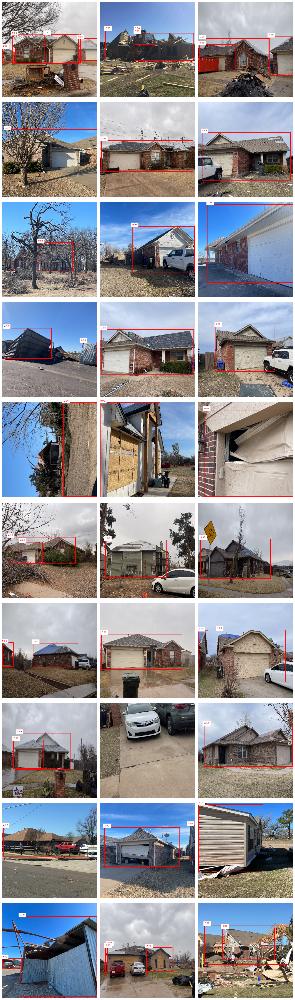

In [23]:
# Visualize predictions
num_rows = 10
num_cols  = 3
confidence_threshold = 0.8

visualize_predictions_grid(images_to_visualize, predictions[:30], num_rows, num_cols, confidence_threshold)

In [24]:
# Save predictions to a JSON file
# save_predictions(predictions, output_file='predictions.json')

In [25]:
# Run inference for pre-trained model
images_to_visualize, image_files_to_visualize, predictions = run_inference(model_pt, 
                                                                           inference_loader, 
                                                                           device, 
                                                                           num_images_to_visualize=30)

Running Inference: 100%|██████████| 80/80 [01:08<00:00,  1.17it/s]


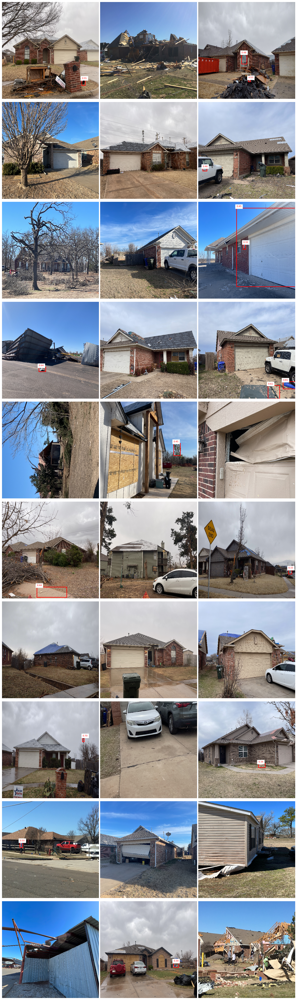

In [27]:
num_rows = 10
num_cols  = 3
confidence_threshold = 0.3

visualize_predictions_grid(images_to_visualize, predictions[:30], num_rows, num_cols, confidence_threshold)